<a href="https://colab.research.google.com/github/nataliasbsg/Dataset_animales/blob/main/net_tester_colab.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# LIBRERIAS
# Importación de archivos desde drive
from google.colab import drive

# Tratamiento de imagenes
import numpy as np
import cv2
import os
import random
import matplotlib.pyplot as plt
import zipfile

# Librerias para la red
import tensorflow as tf
import tensorflow_hub as hub

In [4]:
!wget --no-check-certificate \
    "https://github.com/nataliasbsg/Dataset_animales/archive/refs/heads/master.zip" \
    -O "/tmp/Dataset_animales.zip"


zip_ref = zipfile.ZipFile('/tmp/Dataset_animales.zip', 'r') #Opens the zip file in read mode
zip_ref.extractall('/tmp') #Extracts the files into the /tmp folder
zip_ref.close()

--2022-07-02 18:41:30--  https://github.com/nataliasbsg/Dataset_animales/archive/refs/heads/master.zip
Resolving github.com (github.com)... 140.82.113.3
Connecting to github.com (github.com)|140.82.113.3|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://codeload.github.com/nataliasbsg/Dataset_animales/zip/main [following]
--2022-07-02 18:41:30--  https://codeload.github.com/nataliasbsg/Dataset_animales/zip/main
Resolving codeload.github.com (codeload.github.com)... 140.82.112.10
Connecting to codeload.github.com (codeload.github.com)|140.82.112.10|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [application/zip]
Saving to: ‘/tmp/Dataset_animales.zip’

/tmp/Dataset_animal     [         <=>        ] 765.00M  24.0MB/s    in 27s     

2022-07-02 18:41:58 (28.6 MB/s) - ‘/tmp/Dataset_animales.zip’ saved [802165460]



In [14]:
# Carpeta raiz
dir = '/tmp/Dataset_animales-main'

# Carpeta donde se almacenan los modelos de redes entrenados
dir_modelos = dir + '/Modelos_Redes_Entrenados'
# Se cargan los modelos de las redes
modelo = tf.keras.models.load_model(dir_modelos + '/clasificador_animales.h5',custom_objects={'KerasLayer':hub.KerasLayer})
modelo_cervidos = tf.keras.models.load_model(dir_modelos + '/clasificador_cérvidos.h5',custom_objects={'KerasLayer':hub.KerasLayer})
modelo_felinos = tf.keras.models.load_model(dir_modelos + '/clasificador_felinos.h5',custom_objects={'KerasLayer':hub.KerasLayer})
modelo_leporidos = tf.keras.models.load_model(dir_modelos + '/clasificador_lepóridos.h5',custom_objects={'KerasLayer':hub.KerasLayer})
# Se carga la base de datos de imagenes que se quieren clasificar
# dir_bd = dir + 'bd_tester'
dir_bd = dir + '/RealTest_little'

In [7]:
# Se guardan en categories las familias a clasificas y en subcategorias las especies
categories = ['Canidos', 'Cervidos', 'Felinos', 'Herpestidos', 'Leporidos', 'Mustelidos', 'Suidos', 'Viverridos']
subcategories = [['Zorro'], ['Ciervo', 'Gamo'], ['Gato montes', 'Lince iberico'], ['Meloncillo'], ['Conejo', 'Liebre'], ['Tejon'], ['Jabali'], ['Gineta']]
# Se crean carpetas y subcarpetas para la clasificacion de imagenes
for i, categorie in enumerate(categories):
  for subcategorie in subcategories[i]:
    carpeta_destino = dir + '/animales_clasificados/{}/{}'.format(categorie, subcategorie)
    if not os.path.exists(carpeta_destino):
       os.makedirs(carpeta_destino)


In [8]:
# Se hace un diccionario de modelos para acceder a ellos facilmente
dict_modelos = {
    "Cervidos": modelo_cervidos,
    "Felinos": modelo_felinos,
    "Leporidos": modelo_leporidos
}

In [9]:
# Se crea una clase para sacar información de la imagenes facilmente
class ImagePrediction():
  """ 
  Clase para predecir la especie animal de la imagen dada.

  Attributes
  -----------
  img_original: ndarray
    Imagen leída.
  img: ndarray
    Imagen adaptada para trabajar con ella.
  categorie:  int
    Categoria de la imagen.
  subcategorie:  int    
    Subcategoria de la imagen.
  categorie_real_name: str
    Nombre de categoria de la imagen.
  subcategorie_real_name: str
    Nombre de categoria de la imagen.
  categorie_predict_probability:  array[float]
    Probabilidad de la categoria de la imagen predicha.
  subcategorie_predict_probability:  array[float]
    Probabilidad de la subcategoria de la imagen predicha.
  categorie_predict:  int
    Categoria de la imagen predicha.
  subcategorie_predict:  int
    Subcategoria de la imagen predicha.
  categorie_predict_name: str
    Categoria de la imagen predicha.
  subcategorie_predict_name: str
    Subcategoria de la imagen predicha.
  """
  
  def __init__(self, dir_img):
    self.img_original = cv2.imread(dir_img)
    self.img = np.array(self.img_original).astype(float)/255
    self.img = cv2.resize(self.img, (224,224))
    self.img = np.array(self.img).astype(float)
    self.name = os.path.basename(dir_img)
    self.predict()
	
  def predict(self):
    self.categories_predict_probability = modelo.predict(self.img.reshape(-1, 224, 224, 3))[0]
    self.categorie_predict = np.argmax(self.categories_predict_probability)
    self.categorie_predict_name = categories[self.categorie_predict]
    
    if categories[self.categorie_predict] in dict_modelos:
      modelo_subcategorie = dict_modelos[categories[self.categorie_predict]]
      self.subcategorie_predict_probability = modelo_subcategorie.predict(self.img.reshape(-1, 224, 224, 3))[0]
      self.subcategorie_predict = np.argmax(self.subcategorie_predict_probability)
      self.subcategorie_predict_name = subcategories[self.categorie_predict][self.subcategorie_predict]

    else:
      self.subcategorie_predict_probability = [1]
      self.subcategorie_predict = 0
      self.subcategorie_predict_name = subcategories[self.categorie_predict][self.subcategorie_predict]

In [29]:
num_img = len(os.listdir(dir_bd))
columnas = 4
filas = int(num_img / 4)+1
print(filas)

14


In [21]:
def graficar_imagen(img_graf: ImagePrediction):
  plt.grid(False)
  plt.xticks([])
  plt.yticks([])
  img = img_graf.img[:,:,[2,1,0]]
  plt.imshow(img)

  plt.xlabel("{} {:2.0f}%".format(img_graf.subcategorie_predict_name,
                                100*np.max(img_graf.subcategorie_predict_probability)),
                                fontsize=20)

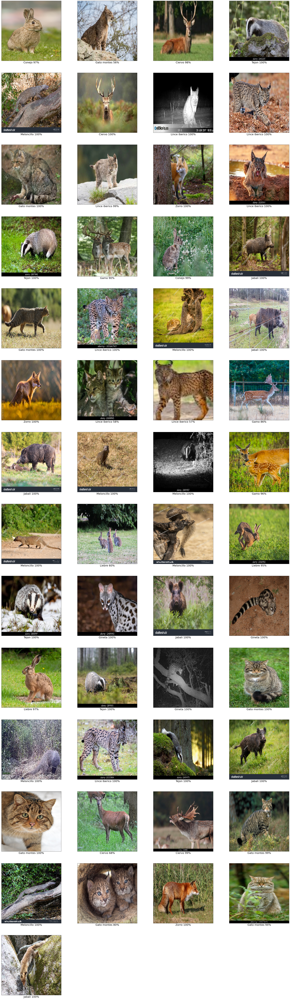

In [34]:
# Se predice la clase de cada imagen con la clase ImagePrediction y se clasifican en carpetas y subcarpetas
plt.figure(figsize=(10*columnas, 10*filas))
for i, img in  enumerate(os.listdir(dir_bd)):
    img2 = ImagePrediction(dir_bd + "/" + img)
    img_category = img2.categorie_predict_name
    img_subcategory = img2.subcategorie_predict_name
    img_name = img2.name
    cv2.imwrite(dir + '/animales_clasificados/{}/{}/{}'.format(img_category, img_subcategory, img_name), img2.img_original)
    plt.subplot(filas, columnas, i+1)
    graficar_imagen(img_graf= img2)

In [18]:
for i, categorie in enumerate(categories):
    for subcategorie in subcategories[i]:
      n_img = len(os.listdir(dir + '/animales_clasificados/{}/{}'.format(categorie, subcategorie)))
      print( f'Se han clasificado como {subcategorie:15} {n_img:3} imágenes') 

Se han clasificado como Zorro             3 imágenes
Se han clasificado como Ciervo            4 imágenes
Se han clasificado como Gamo              3 imágenes
Se han clasificado como Gato montes       8 imágenes
Se han clasificado como Lince iberico     8 imágenes
Se han clasificado como Meloncillo        8 imágenes
Se han clasificado como Conejo            2 imágenes
Se han clasificado como Liebre            3 imágenes
Se han clasificado como Tejon             5 imágenes
Se han clasificado como Jabali            6 imágenes
Se han clasificado como Gineta            3 imágenes
